In [1]:
import py3Dmol

In [2]:
with open("7dti.pdb") as ifile:
    system = "".join([x for x in ifile])

In [3]:
view = py3Dmol.view(width=500, height=500)
view.addModelsAsFrames(system)
view.setStyle({'model': -1}, {"cartoon": {'color': 'spectrum'}})
view.zoomTo()
view.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [ ]:
import pickle
import torch
import matplotlib.pyplot as plt

In [5]:
file = open("wt1.pkl",'rb')
object_file = pickle.load(file)
file.close()

In [19]:
ls = [(o-min(object_file))/(max(object_file)-min(object_file)) for o in object_file]

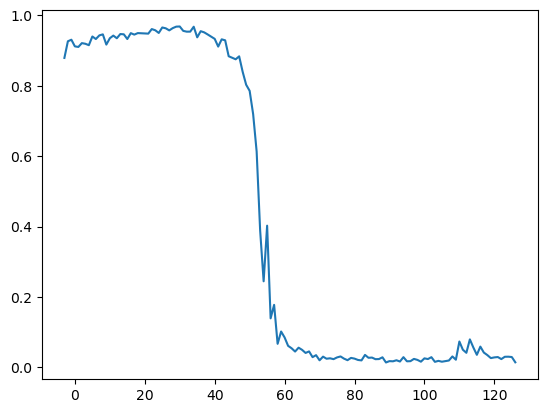

In [8]:
plt.plot([i-3 for i in range(len(object_file))],object_file)

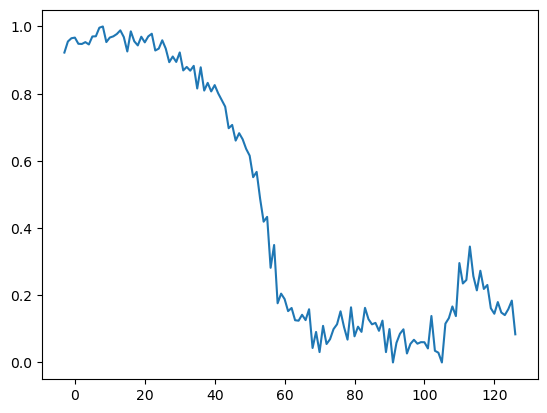

In [21]:
plt.plot([i-3 for i in range(len(object_file))],ls)

In [6]:
import matplotlib.cm as cm
from matplotlib.colors import to_hex
import matplotlib as mpl

In [8]:
color_map = {i: to_hex(cm.bwr(bands)) for i, bands in enumerate(object_file)}

In [11]:
show_sidechains = False
view = py3Dmol.view(width=800, height=600)
#view.setBackgroundColor('#000000')
view.addModelsAsFrames(system)
style = {'cartoon': {'colorscheme': {'prop': 'resi','map': color_map}}}
styleB = {'cartoon': {}}
if show_sidechains:
  style['stick'] = {}
view.setStyle({'chain':'A','model': -1}, style)
view.setStyle({'chain':'B','model': -1}, styleB)
view.addLabel("1.0                                   0.0",
           {'position':{'x':0,'y':0,'z':0},'useScreen': True, 'fontSize': 12, 
            'borderThickness': 0.5, 'borderColor': 'black', 
            'backgroundGradient': {'gradient':'rwb','min':0.0,'mid':0.5,'max':1.0}})
#style = {'cartoon': {'colorscheme': {'prop': 'resi','map': color_map}}}
#view.animate()
view.zoomTo()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [13]:
view.png()

In [4]:
show_sidechains = True
def plot_plddt_legend():
  """Plots the legend for pLDDT."""
  thresh = ['Very low (pLDDT < 50)',
            'Low (70 > pLDDT > 50)',
            'Confident (90 > pLDDT > 70)',
            'Very high (pLDDT > 90)']

  colors = [x[2] for x in PLDDT_BANDS]

  plt.figure(figsize=(2, 2))
  for c in colors:
    plt.bar(0, 0, color=c)
  plt.legend(thresh, frameon=False, loc='center', fontsize=20)
  plt.xticks([])
  plt.yticks([])
  ax = plt.gca()
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  plt.title('Model Confidence', fontsize=20, pad=20)
  return plt